<a href="https://colab.research.google.com/github/VictorNigretto/ProjetLong/blob/main/Segmentation_multi_image_superpixels_%2B_shadow_removal_%2B_mean_color_%2B_KPPV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Pipeline of this colab :

Import -> Shadow removal -> Segmentation of the images with quickshift -> Mean_Color on superpixels -> Kneighborhoods clustering

Install management

In [1]:
!pip install rasterio

     |████████████████████████████████| 19.1MB 1.3MB/s 


Import management


In [2]:
import os
import shutil
from tensorflow.python.client import device_lib
import keras
from keras import layers, models, optimizers
from keras.layers.convolutional import Conv2D, MaxPooling2D
from keras.layers import Dense, Flatten, Dropout, Input
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.applications import EfficientNetB7, ResNet50
from keras.preprocessing import image
from keras.models import Model
from keras.callbacks import LearningRateScheduler
import pandas as pd
import tensorflow as tf
import numpy as np
import matplotlib
from keras.preprocessing.image import load_img
from PIL import Image
from keras.utils import to_categorical 
import cv2
from google.colab.patches import cv2_imshow
import random
from keras.preprocessing.image import load_img
from skimage.transform import rescale, resize, downscale_local_mean
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
import matplotlib.pyplot as plt
import gc
import numpy as np
import pandas as pd
import rasterio
from skimage.color import lab2lch, rgb2lab, rgb2hsv, rgb2gray, hsv2rgb, lab2rgb
from skimage.exposure import rescale_intensity
from skimage.morphology import disk
from sklearn.cluster import KMeans
import scipy.misc
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import normalize

Upload files

In [3]:
from google.colab import files
uploaded = files.upload()

Saving 100_0001_0001.JPG to 100_0001_0001.JPG


In [4]:
uploaded = files.upload()

Saving 100_0001_0005.JPG to 100_0001_0005.JPG


In [5]:
uploaded = files.upload()

Saving 100_0001_0025.JPG to 100_0001_0025.JPG


In [6]:
uploaded = files.upload()

Saving 100_0001_0102.JPG to 100_0001_0102.JPG


In [7]:
uploaded = files.upload()

Saving 100_0001_0200.JPG to 100_0001_0200.JPG


In [8]:
uploaded = files.upload()

Saving 100_0001_0116.JPG to 100_0001_0116.JPG


Load basic image and resize

In [9]:
# Basic image loading
basic_image = load_img('100_0001_0116.JPG')
print("Image shape : ", np.shape(basic_image))

basic_image = np.array(basic_image)

# Resize : You can change the resize if you want to work with HD pictures
basic_image = rescale(basic_image, 0.10, multichannel=True, anti_aliasing=True)
matplotlib.image.imsave('100_0001_0116_resized.JPG', basic_image)

Image shape :  (3648, 5472, 3)


Load other images

In [10]:
# Resize
image_1 = rescale(np.array(load_img('100_0001_0001.JPG')), 0.10, multichannel=True, anti_aliasing=True)
image_2 = rescale(np.array(load_img('100_0001_0005.JPG')), 0.10, multichannel=True, anti_aliasing=True)
image_3 = rescale(np.array(load_img('100_0001_0025.JPG')), 0.10, multichannel=True, anti_aliasing=True)
image_4 = rescale(np.array(load_img('100_0001_0102.JPG')), 0.10, multichannel=True, anti_aliasing=True)
image_5 = rescale(np.array(load_img('100_0001_0200.JPG')), 0.10, multichannel=True, anti_aliasing=True)

# Save
matplotlib.image.imsave('100_0001_0001_resized.JPG', image_1)
matplotlib.image.imsave('100_0001_0005_resized.JPG', image_2)
matplotlib.image.imsave('100_0001_0025_resized.JPG', image_3)
matplotlib.image.imsave('100_0001_0102_resized.JPG', image_4)
matplotlib.image.imsave('100_0001_0200_resized.JPG', image_5)

Display image

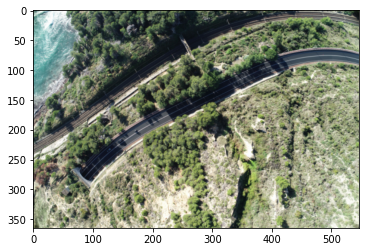

image reshaped shape :  (365, 547, 3)


In [11]:
plt.imshow(basic_image)
plt.show()
print("image reshaped shape : ", np.shape(basic_image))

Display images

Text(0.5, 1.0, 'Image 5')

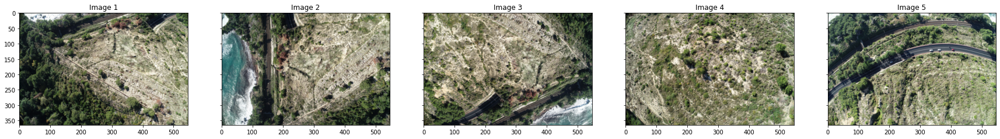

In [12]:
# Display 5 other images
fig, ax = plt.subplots(1, 5, figsize=(30, 30), sharex=True, sharey=True)

ax[0].imshow(image_1)
ax[0].set_title('Image 1')

ax[1].imshow(image_2)
ax[1].set_title('Image 2')

ax[2].imshow(image_3)
ax[2].set_title('Image 3')

ax[3].imshow(image_4)
ax[3].set_title('Image 4')

ax[4].imshow(image_5)
ax[4].set_title('Image 5')

Shadow Detection and Reconstruction in High-Resolution Satellite Images via Morphological Filtering and Example-Based Learning


In [13]:
def shadow_detection(image_file, shadow_mask_file, convolve_window_size = 5, num_thresholds = 3, struc_elem_size = 5):
    """
    This function is used to detect shadow - covered areas in an image, as proposed in the paper 
    'Near Real - Time Shadow Detection and Removal in Aerial Motion Imagery Application' by Silva G.F., Carneiro G.B., 
    Doth R., Amaral L.A., de Azevedo D.F.G. (2017)
    
    Inputs:
    - image_file: Path of image to be processed for shadow removal. It is assumed that the first 3 channels are ordered as
                  Red, Green and Blue respectively
    - shadow_mask_file: Path of shadow mask to be saved
    - convolve_window_size: Size of convolutional matrix filter to be used for blurring of specthem ratio image
    - num_thresholds: Number of thresholds to be used for automatic multilevel global threshold determination
    - struc_elem_size: Size of disk - shaped structuring element to be used for morphological closing operation
    
    Outputs:
    - shadow_mask: Shadow mask for input image
    
    """
    
    if (convolve_window_size % 2 == 0):
        raise ValueError('Please make sure that convolve_window_size is an odd integer')
        
    buffer = int((convolve_window_size - 1) / 2)
    
    
    with rasterio.open(image_file) as f:
        metadata = f.profile
        img = rescale_intensity(np.transpose(f.read(tuple(np.arange(metadata['count']) + 1)), [1, 2, 0]), out_range = 'uint8')
        img = img[:, :, 0 : 3]
    
    
    lch_img = np.float32(lab2lch(rgb2lab(img)))
    
    
    l_norm = rescale_intensity(lch_img[:, :, 0], out_range = (0, 1))
    h_norm = rescale_intensity(lch_img[:, :, 2], out_range = (0, 1))
    sr_img = (h_norm + 1) / (l_norm + 1)
    log_sr_img = np.log(sr_img + 1)
    
    del l_norm, h_norm, sr_img
    gc.collect()

    

    avg_kernel = np.ones((convolve_window_size, convolve_window_size)) / (convolve_window_size ** 2)
    blurred_sr_img = cv2.filter2D(log_sr_img, ddepth = -1, kernel = avg_kernel)
      
    
    del log_sr_img
    gc.collect()
    
                
    flattened_sr_img = blurred_sr_img.flatten().reshape((-1, 1))
    labels = KMeans(n_clusters = num_thresholds + 1, max_iter = 10000).fit(flattened_sr_img).labels_
    flattened_sr_img = flattened_sr_img.flatten()
    df = pd.DataFrame({'sample_pixels': flattened_sr_img, 'cluster': labels})
    threshold_value = df.groupby(['cluster']).min().max()[0]
    df['Segmented'] = np.uint8(df['sample_pixels'] >= threshold_value)
    
    
    del blurred_sr_img, flattened_sr_img, labels, threshold_value
    gc.collect()
    
    
    shadow_mask_initial = np.array(df['Segmented']).reshape((img.shape[0], img.shape[1]))
    struc_elem = disk(struc_elem_size)
    shadow_mask = np.expand_dims(np.uint8(cv2.morphologyEx(shadow_mask_initial, cv2.MORPH_CLOSE, struc_elem)), axis = 0)
    
    
    del df, shadow_mask_initial, struc_elem
    gc.collect()
    

    metadata['count'] = 1
    with rasterio.open(shadow_mask_file, 'w', **metadata) as dst:
        dst.write(shadow_mask)
        
    return shadow_mask



def shadow_correction(image_file, shadow_mask_file, corrected_image_file, exponent = 1):
    """
    This function is used to adjust brightness for shadow - covered areas in an image, as proposed in the paper 
    'Near Real - Time Shadow Detection and Removal in Aerial Motion Imagery Application' by Silva G.F., Carneiro G.B., 
    Doth R., Amaral L.A., de Azevedo D.F.G. (2017)
    
    Inputs:
    - image_file: Path of 3 - channel (red, green, blue) image to be processed for shadow removal
    - shadow_mask_file: Path of shadow mask for corresponding input image
    - corrected_image_file: Path of corrected image to be saved
    - exponent: Exponent to be used for the calculcation of statistics for unshaded and shaded areas
    
    Outputs:
    - corrected_img: Corrected input image
    
    """
    
    with rasterio.open(image_file) as f:
        metadata = f.profile
        img = rescale_intensity(np.transpose(f.read(tuple(np.arange(metadata['count']) + 1)), [1, 2, 0]), out_range = 'uint8')
        
    with rasterio.open(shadow_mask_file) as s:
        shadow_mask = s.read(1)
    
    corrected_img = np.zeros((img.shape), dtype = np.uint8)
    non_shadow_mask = np.uint8(shadow_mask == 0)
    
    
    for i in range(img.shape[2]):
        shadow_area_mask = shadow_mask * img[:, :, i]
        non_shadow_area_mask = non_shadow_mask * img[:, :, i]
        shadow_stats = np.float32(np.mean(((shadow_area_mask ** exponent) / np.sum(shadow_mask))) ** (1 / exponent))
        non_shadow_stats = np.float32(np.mean(((non_shadow_area_mask ** exponent) / np.sum(non_shadow_mask))) ** (1 / exponent))
        mul_ratio = ((non_shadow_stats - shadow_stats) / shadow_stats) + 1
        corrected_img[:, :, i] = np.uint8(non_shadow_area_mask + np.clip(shadow_area_mask * mul_ratio, 0, 255))
    

    with rasterio.open(corrected_image_file, 'w', **metadata) as dst:
        dst.write(np.transpose(corrected_img, [2, 0, 1]))
        
    return corrected_img

Shadow mask


In [14]:
basic_mask = shadow_detection("/content/100_0001_0116_resized.JPG", "/content/basic_shadow_image.JPG")
mask_1 = shadow_detection("/content/100_0001_0001_resized.JPG", "/content/shadow_image_1.JPG")
mask_2 = shadow_detection("/content/100_0001_0005_resized.JPG", "/content/shadow_image_2.JPG")
mask_3 = shadow_detection("/content/100_0001_0025_resized.JPG", "/content/shadow_image_3.JPG")
mask_4 = shadow_detection("/content/100_0001_0102_resized.JPG", "/content/shadow_image_4.JPG")
mask_5 = shadow_detection("/content/100_0001_0200_resized.JPG", "/content/shadow_image_5.JPG")

/usr/local/lib/python3.7/dist-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.7/dist-packages/rasterio/__init__.py:223: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  **kwargs)
/usr/local/lib/python3.7/dist-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.7/dist-packages/rasterio/__init__.py:223: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising a

Corrected image - Without shadow

In [15]:
basic_corrected_image = shadow_correction("/content/100_0001_0116_resized.JPG", "/content/basic_shadow_image.JPG", "/content/basic_corrected_image.JPG")
corrected_image_1 = shadow_correction("/content/100_0001_0001_resized.JPG", "/content/shadow_image_1.JPG", "/content/corrected_image_1.JPG")
corrected_image_2 = shadow_correction("/content/100_0001_0005_resized.JPG", "/content/shadow_image_2.JPG", "/content/corrected_image_2.JPG")
corrected_image_3 = shadow_correction("/content/100_0001_0025_resized.JPG", "/content/shadow_image_3.JPG", "/content/corrected_image_3.JPG")
corrected_image_4 = shadow_correction("/content/100_0001_0102_resized.JPG", "/content/shadow_image_4.JPG", "/content/corrected_image_4.JPG")
corrected_image_5 = shadow_correction("/content/100_0001_0200_resized.JPG", "/content/shadow_image_5.JPG", "/content/corrected_image_5.JPG")

/usr/local/lib/python3.7/dist-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.7/dist-packages/rasterio/__init__.py:223: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  **kwargs)


Data engineering to make it match with other format

In [16]:
basic_mask = basic_mask[0, :, :]
mask_1 = mask_1[0, :, :]
mask_2 = mask_2[0, :, :]
mask_3 = mask_3[0, :, :]
mask_4 = mask_4[0, :, :]
mask_5 = mask_5[0, :, :]

Display corrected image : Without shadow

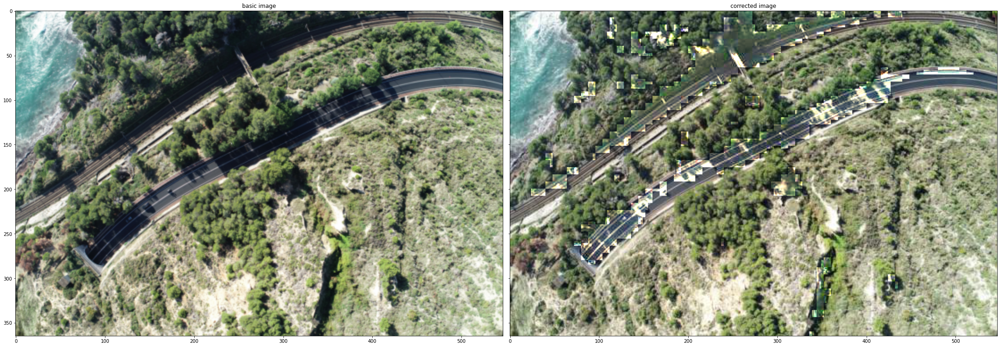

In [17]:
fig, ax = plt.subplots(1, 2, figsize=(30, 30), sharex=True, sharey=True)

ax[0].imshow(basic_image)
ax[0].set_title('basic image')

ax[1].imshow(basic_corrected_image)
ax[1].set_title('corrected image')

plt.tight_layout()
plt.show()

Segmentation with quickshift

Quickshift number of segments: 389


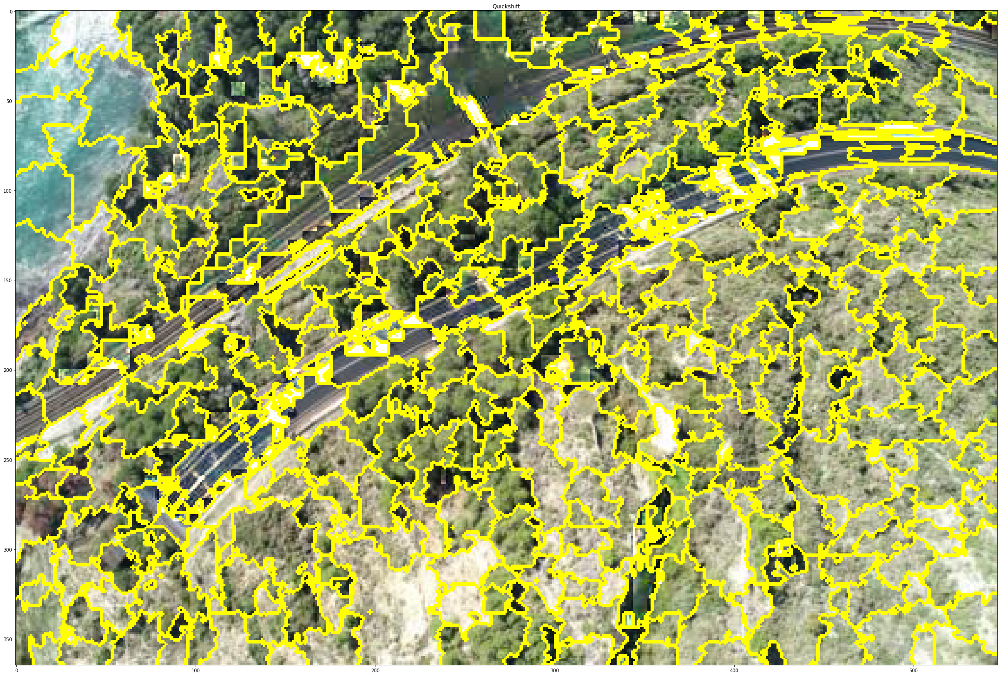

In [18]:
# Image : 0-255 -> 0-1
float_basic_image = img_as_float(basic_corrected_image)

# Quickshift segmentation : see sklearn doc
basic_segments_quick = quickshift(float_basic_image, kernel_size=3, max_dist=20, ratio=0.5)

print(f"Quickshift number of segments: {len(np.unique(basic_segments_quick))}")
fig, ax = plt.subplots(1, 1, figsize=(30, 30), sharex=True, sharey=True)

# Superpixel display
ax.imshow(mark_boundaries(float_basic_image, basic_segments_quick))
ax.set_title('Quickshift')

plt.tight_layout()
plt.show()

Segmentation of 5 image with quickshift

Quickshift 1 number of segments: 337
Quickshift 2 number of segments: 353
Quickshift 3 number of segments: 345
Quickshift 4 number of segments: 395
Quickshift 5 number of segments: 370


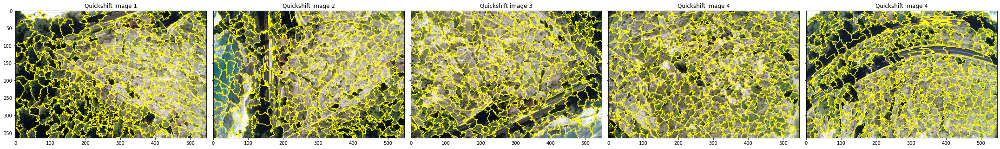

In [19]:
# Same but with 5 other images :
float_image_1 = img_as_float(image_1)
float_image_2 = img_as_float(image_2)
float_image_3 = img_as_float(image_3)
float_image_4 = img_as_float(image_4)
float_image_5 = img_as_float(image_5)


segments_quick_1 = quickshift(float_image_1, kernel_size=3, max_dist=20, ratio=0.5)
segments_quick_2 = quickshift(float_image_2, kernel_size=3, max_dist=20, ratio=0.5)
segments_quick_3 = quickshift(float_image_3, kernel_size=3, max_dist=20, ratio=0.5)
segments_quick_4 = quickshift(float_image_4, kernel_size=3, max_dist=20, ratio=0.5)
segments_quick_5 = quickshift(float_image_5, kernel_size=3, max_dist=20, ratio=0.5)

print(f"Quickshift 1 number of segments: {len(np.unique(segments_quick_1))}")
print(f"Quickshift 2 number of segments: {len(np.unique(segments_quick_2))}")
print(f"Quickshift 3 number of segments: {len(np.unique(segments_quick_3))}")
print(f"Quickshift 4 number of segments: {len(np.unique(segments_quick_4))}")
print(f"Quickshift 5 number of segments: {len(np.unique(segments_quick_5))}")

fig, ax = plt.subplots(1, 5, figsize=(30, 30), sharex=True, sharey=True)


ax[0].imshow(mark_boundaries(float_image_1, segments_quick_1))
ax[0].set_title('Quickshift image 1')

ax[1].imshow(mark_boundaries(float_image_2, segments_quick_2))
ax[1].set_title('Quickshift image 2')

ax[2].imshow(mark_boundaries(float_image_3, segments_quick_3))
ax[2].set_title('Quickshift image 3')

ax[3].imshow(mark_boundaries(float_image_4, segments_quick_4))
ax[3].set_title('Quickshift image 4')

ax[4].imshow(mark_boundaries(float_image_5, segments_quick_5))
ax[4].set_title('Quickshift image 4')

plt.tight_layout()
plt.show()

Mean color function

In [20]:
def mean_color(image=basic_image, segments=basic_segments_quick):
  """
  Take as input : image and its segments of quickshift, and display the image with mean color on every superpixels
  """
  img_reshaped = image.reshape((image.shape[0]*image.shape[1],image.shape[2]))
  print("img reshaped shape", np.shape(img_reshaped))

  segments_reshaped = np.reshape(segments, -1)    
  print("segment reshaped shape", np.shape(segments_reshaped))

  unique_segments = np.unique(segments_reshaped)
  print("unique segment shape", np.shape(unique_segments))
  img_temp = np.zeros(img_reshaped.shape)

  for i in unique_segments:
    loc=np.where(segments_reshaped==i)[0]
    #print(loc)
    means=np.mean(img_reshaped[loc, :], axis=0)
    img_temp[loc, :] = means

  return np.reshape(img_temp, [image.shape[0], image.shape[1], image.shape[2]])

In [21]:
# Mean img
basic_mean_img = mean_color(float_basic_image, basic_segments_quick)
mean_img_1 = mean_color(float_image_1, segments_quick_1)
mean_img_2 = mean_color(float_image_2, segments_quick_2)
mean_img_3 = mean_color(float_image_3, segments_quick_3)
mean_img_4 = mean_color(float_image_4, segments_quick_4)
mean_img_5 = mean_color(float_image_5, segments_quick_5)

img reshaped shape (199655, 3)
segment reshaped shape (199655,)
unique segment shape (389,)
img reshaped shape (199655, 3)
segment reshaped shape (199655,)
unique segment shape (337,)
img reshaped shape (199655, 3)
segment reshaped shape (199655,)
unique segment shape (353,)
img reshaped shape (199655, 3)
segment reshaped shape (199655,)
unique segment shape (345,)
img reshaped shape (199655, 3)
segment reshaped shape (199655,)
unique segment shape (395,)
img reshaped shape (199655, 3)
segment reshaped shape (199655,)
unique segment shape (370,)


Display : Basic image - Shadow mask - Corrected image - Mean color corrected image

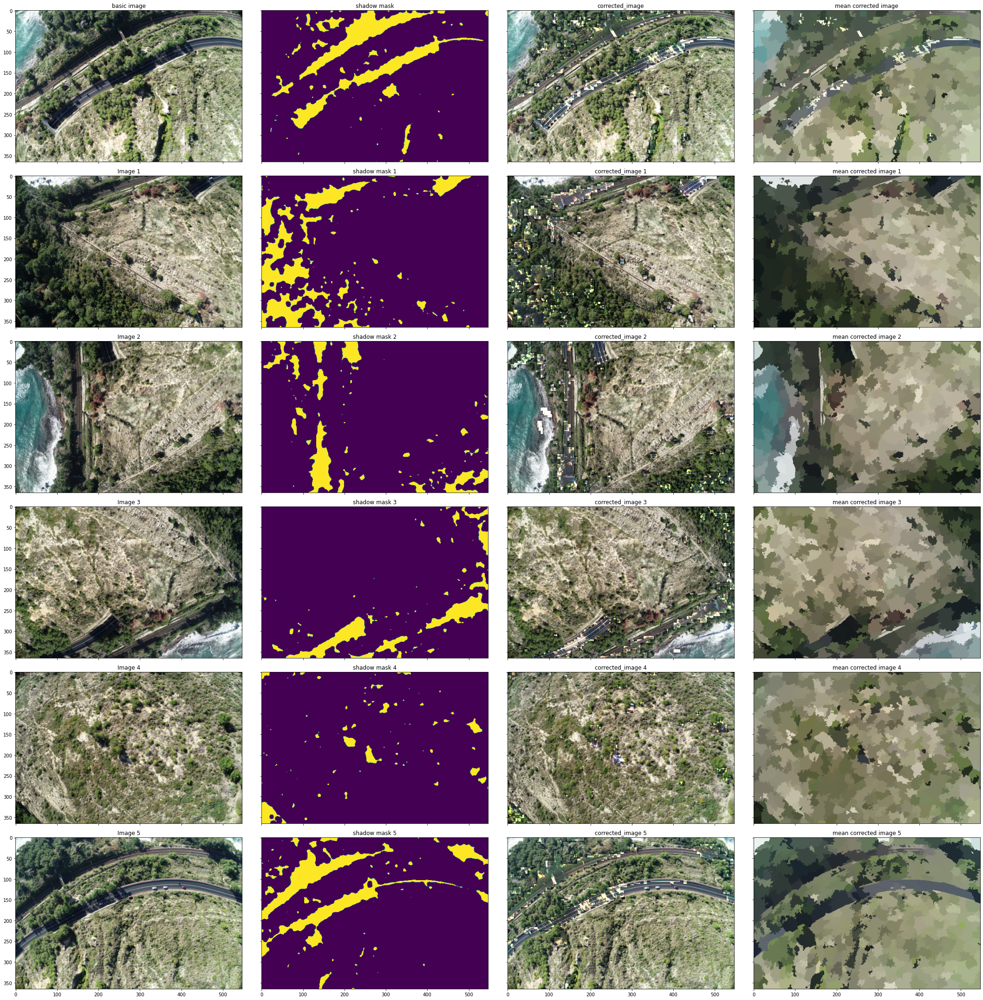

In [22]:
# Affichage
fig, ax = plt.subplots(6, 4, figsize=(30, 30), sharex=True, sharey=True)

# Basic image
ax[0, 0].imshow(basic_image)
ax[0, 0].set_title('basic image')
ax[0, 1].imshow(basic_mask)
ax[0, 1].set_title('shadow mask')
ax[0, 2].imshow(basic_corrected_image)
ax[0, 2].set_title('corrected_image')
ax[0, 3].imshow(basic_mean_img)
ax[0, 3].set_title('mean corrected image')

# Image 1
ax[1, 0].imshow(image_1)
ax[1, 0].set_title('Image 1')
ax[1, 1].imshow(mask_1)
ax[1, 1].set_title('shadow mask 1')
ax[1, 2].imshow(corrected_image_1)
ax[1, 2].set_title('corrected_image 1')
ax[1, 3].imshow(mean_img_1)
ax[1, 3].set_title('mean corrected image 1')

# Image 2
ax[2, 0].imshow(image_2)
ax[2, 0].set_title('Image 2')
ax[2, 1].imshow(mask_2)
ax[2, 1].set_title('shadow mask 2')
ax[2, 2].imshow(corrected_image_2)
ax[2, 2].set_title('corrected_image 2')
ax[2, 3].imshow(mean_img_2)
ax[2, 3].set_title('mean corrected image 2')

# Image 3
ax[3, 0].imshow(image_3)
ax[3, 0].set_title('Image 3')
ax[3, 1].imshow(mask_3)
ax[3, 1].set_title('shadow mask 3')
ax[3, 2].imshow(corrected_image_3)
ax[3, 2].set_title('corrected_image 3')
ax[3, 3].imshow(mean_img_3)
ax[3, 3].set_title('mean corrected image 3')

# Image 4 
ax[4, 0].imshow(image_4)
ax[4, 0].set_title('Image 4')
ax[4, 1].imshow(mask_4)
ax[4, 1].set_title('shadow mask 4')
ax[4, 2].imshow(corrected_image_4)
ax[4, 2].set_title('corrected_image 4')
ax[4, 3].imshow(mean_img_4)
ax[4, 3].set_title('mean corrected image 4')

# Image 5
ax[5, 0].imshow(image_5)
ax[5, 0].set_title('Image 5')
ax[5, 1].imshow(mask_5)
ax[5, 1].set_title('shadow mask 5')
ax[5, 2].imshow(corrected_image_5)
ax[5, 2].set_title('corrected_image 5')
ax[5, 3].imshow(mean_img_5)
ax[5, 3].set_title('mean corrected image 5')

plt.tight_layout()
plt.show()


Visualization of point cloud with RGB, HSV and LAB format

In [24]:
def cloud_repartition_rgb_img(img=basic_mean_img, segments=basic_segments_quick):
  """
  Take as input : an image and it's quickshift segments, and display the cloud of the means colors in RGB format
  """
  img_reshaped = img.reshape((img.shape[0]*img.shape[1], img.shape[2]))
  print("img reshaped shape :", np.shape(img_reshaped))
  segments_reshaped = np.reshape(segments, -1)    
  print("segment reshaped shape", np.shape(segments_reshaped))

  unique_segments = np.unique(segments_reshaped)
  print("unique segment shape", np.shape(unique_segments))
  img_unique_pixels = np.zeros((unique_segments.shape[0], 3))
  print("img unique pixel shape :", np.shape(img_unique_pixels))

  for i in unique_segments:
    loc=np.where(segments_reshaped==i)[0][0]
    #print(loc)
    img_unique_pixels[i, :] = img_reshaped[loc, :]

  img_unique_pixels = 255*img_unique_pixels
  print(np.shape(img_unique_pixels))

  # Display
  fig = plt.figure()
  ax3D = fig.add_subplot(111, projection='3d')

  # Plot
  p3d = ax3D.scatter(img_unique_pixels[:, 0], img_unique_pixels[:, 1], img_unique_pixels[:, 2], zdir='z', s=20, c='red', depthshade=True) 


  # Axes
  ax3D.set_xlabel('R Label')
  ax3D.set_ylabel('G Label')
  ax3D.set_zlabel('B Label')

In [25]:
def cloud_repartition_hsv_img(img=basic_mean_img, segments=basic_segments_quick):
  """
  Take as input : an image and it's quickshift segment and display the cloud of it's means colors in HSV format
  """

  img = rgb2hsv(img)
  #print(img)
  img_reshaped = img.reshape((img.shape[0]*img.shape[1], img.shape[2]))
  print("img reshaped shape :", np.shape(img_reshaped))
  segments_reshaped = np.reshape(segments, -1)    
  print("segment reshaped shape", np.shape(segments_reshaped))

  unique_segments = np.unique(segments_reshaped)
  print("unique segment shape", np.shape(unique_segments))
  img_unique_pixels = np.zeros((unique_segments.shape[0], 3))
  print("img unique pixel shape :", np.shape(img_unique_pixels))

  for i in unique_segments:
    loc=np.where(segments_reshaped==i)[0][0]
    #print(loc)
    img_unique_pixels[i, :] = img_reshaped[loc, :]

  # Display
  fig = plt.figure()
  ax3D = fig.add_subplot(111, projection='3d')

  # Plot
  p3d = ax3D.scatter(img_unique_pixels[:, 0], img_unique_pixels[:, 1], img_unique_pixels[:, 2], zdir='z', s=20, c='red', depthshade=True) 


  # Axes
  ax3D.set_xlabel('H Label')
  ax3D.set_ylabel('S Label')
  ax3D.set_zlabel('V Label')

In [26]:
def cloud_repartition_lab_img(img=basic_mean_img, segments=basic_segments_quick):
  """
  Take as input : an image and it's quickshift segments and display the cloud of it's means colors with LAB format
  """
  img = rgb2lab(img)
  img_reshaped = img.reshape((img.shape[0]*img.shape[1], img.shape[2]))
  print("img reshaped shape :", np.shape(img_reshaped))
  segments_reshaped = np.reshape(segments, -1)    
  print("segment reshaped shape", np.shape(segments_reshaped))

  unique_segments = np.unique(segments_reshaped)
  print("unique segment shape", np.shape(unique_segments))
  img_unique_pixels = np.zeros((unique_segments.shape[0], 3))
  print("img unique pixel shape :", np.shape(img_unique_pixels))

  for i in unique_segments:
    loc=np.where(segments_reshaped==i)[0][0]
    #print(loc)
    img_unique_pixels[i, :] = img_reshaped[loc, :]

  #img_unique_pixels = 255*img_unique_pixels
  print(np.shape(img_unique_pixels))

  # Display
  fig = plt.figure()
  ax3D = fig.add_subplot(111, projection='3d')

  # Plot
  p3d = ax3D.scatter(img_unique_pixels[:, 0], img_unique_pixels[:, 1], img_unique_pixels[:, 2], zdir='z', s=20, c='red', depthshade=True) 


  # Axes
  ax3D.set_xlabel('L Label')
  ax3D.set_ylabel('A Label')
  ax3D.set_zlabel('B Label')


Display

img reshaped shape : (199655, 3)
segment reshaped shape (199655,)
unique segment shape (389,)
img unique pixel shape : (389, 3)
(389, 3)
img reshaped shape : (199655, 3)
segment reshaped shape (199655,)
unique segment shape (389,)
img unique pixel shape : (389, 3)
img reshaped shape : (199655, 3)
segment reshaped shape (199655,)
unique segment shape (389,)
img unique pixel shape : (389, 3)
(389, 3)


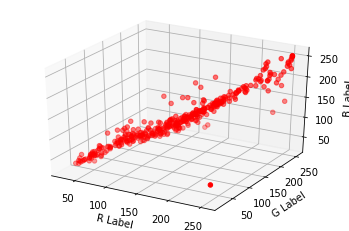

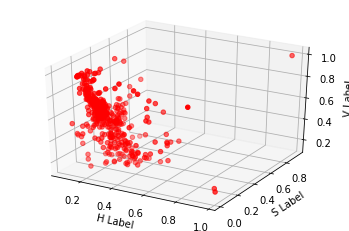

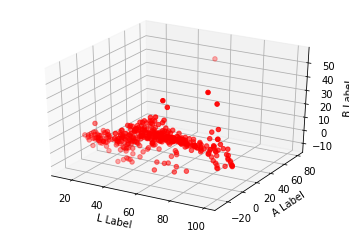

In [27]:
# Display
cloud_repartition_rgb_img()
cloud_repartition_hsv_img()
cloud_repartition_lab_img()

Some data engineering for the next functions ...

In [28]:
# This code defines for every image "img_unique_pixels_rgb", wich is the vector of the mean colors
basic_img_reshaped = basic_mean_img.reshape((basic_mean_img.shape[0]*basic_mean_img.shape[1], basic_mean_img.shape[2]))
basic_segments_reshaped = np.reshape(basic_segments_quick, -1)    
basic_unique_segments = np.unique(basic_segments_reshaped)
basic_img_unique_pixels_rgb = np.zeros((basic_unique_segments.shape[0], 3))
print("basic img unique pixel shape :", np.shape(basic_img_unique_pixels_rgb))

for i in basic_unique_segments:
  loc=np.where(basic_segments_reshaped==i)[0][0]
  #print(loc)
  basic_img_unique_pixels_rgb[i, :] = basic_img_reshaped[loc, :]

# Image 1
img_reshaped_1 = mean_img_1.reshape((mean_img_1.shape[0]*mean_img_1.shape[1], mean_img_1.shape[2]))
segments_reshaped_1 = np.reshape(segments_quick_1, -1)    
unique_segments_1 = np.unique(segments_reshaped_1)
img_unique_pixels_rgb_1 = np.zeros((unique_segments_1.shape[0], 3))
print("img 1 unique pixel shape :", np.shape(img_unique_pixels_rgb_1))

for i in unique_segments_1:
  loc=np.where(segments_reshaped_1==i)[0][0]
  #print(loc)
  img_unique_pixels_rgb_1[i, :] = img_reshaped_1[loc, :]

# Image 2
img_reshaped_2 = mean_img_2.reshape((mean_img_2.shape[0]*mean_img_2.shape[1], mean_img_2.shape[2]))
segments_reshaped_2 = np.reshape(segments_quick_2, -1)    
unique_segments_2 = np.unique(segments_reshaped_2)
img_unique_pixels_rgb_2 = np.zeros((unique_segments_2.shape[0], 3))
print("img 2 unique pixel shape :", np.shape(img_unique_pixels_rgb_2))

for i in unique_segments_2:
  loc=np.where(segments_reshaped_2==i)[0][0]
  #print(loc)
  img_unique_pixels_rgb_2[i, :] = img_reshaped_2[loc, :]

# Image 3
img_reshaped_3 = mean_img_3.reshape((mean_img_3.shape[0]*mean_img_3.shape[1], mean_img_3.shape[2]))
segments_reshaped_3 = np.reshape(segments_quick_3, -1)    
unique_segments_3 = np.unique(segments_reshaped_3)
img_unique_pixels_rgb_3 = np.zeros((unique_segments_3.shape[0], 3))
print("img 3 unique pixel shape :", np.shape(img_unique_pixels_rgb_3))

for i in unique_segments_3:
  loc=np.where(segments_reshaped_3==i)[0][0]
  #print(loc)
  img_unique_pixels_rgb_3[i, :] = img_reshaped_3[loc, :]

# Image 4
img_reshaped_4 = mean_img_4.reshape((mean_img_4.shape[0]*mean_img_4.shape[1], mean_img_4.shape[2]))
segments_reshaped_4 = np.reshape(segments_quick_4, -1)    
unique_segments_4 = np.unique(segments_reshaped_4)
img_unique_pixels_rgb_4 = np.zeros((unique_segments_4.shape[0], 3))
print("img 4 unique pixel shape :", np.shape(img_unique_pixels_rgb_4))

for i in unique_segments_4:
  loc=np.where(segments_reshaped_4==i)[0][0]
  #print(loc)
  img_unique_pixels_rgb_4[i, :] = img_reshaped_4[loc, :]

# Image 5
img_reshaped_5 = mean_img_5.reshape((mean_img_5.shape[0]*mean_img_5.shape[1], mean_img_5.shape[2]))
segments_reshaped_5 = np.reshape(segments_quick_5, -1)    
unique_segments_5 = np.unique(segments_reshaped_5)
img_unique_pixels_rgb_5 = np.zeros((unique_segments_5.shape[0], 3))
print("img 5 unique pixel shape :", np.shape(img_unique_pixels_rgb_5))

for i in unique_segments_5:
  loc=np.where(segments_reshaped_5==i)[0][0]
  #print(loc)
  img_unique_pixels_rgb_5[i, :] = img_reshaped_5[loc, :]


basic img unique pixel shape : (389, 3)
img 1 unique pixel shape : (337, 3)
img 2 unique pixel shape : (353, 3)
img 3 unique pixel shape : (345, 3)
img 4 unique pixel shape : (395, 3)
img 5 unique pixel shape : (370, 3)


In [29]:
# Same as above but in HSVV format
mean_img_hsv = rgb2hsv(basic_mean_img)
basic_img_reshaped = basic_mean_img.reshape((mean_img_hsv.shape[0]*mean_img_hsv.shape[1], mean_img_hsv.shape[2]))
segments_reshaped = np.reshape(basic_segments_quick, -1)    
basic_unique_segments = np.unique(segments_reshaped)
basic_img_unique_pixels_hsv = np.zeros((basic_unique_segments.shape[0], 3))
print("img unique pixel shape :", np.shape(basic_img_unique_pixels_hsv))

for i in basic_unique_segments:
  loc=np.where(segments_reshaped==i)[0][0]
  #print(loc)
  basic_img_unique_pixels_hsv[i, :] = basic_img_reshaped[loc, :]

img unique pixel shape : (389, 3)


In [30]:
# Same as above but in LAB format
mean_img_lab = rgb2hsv(basic_mean_img)
basic_img_reshaped = mean_img_lab.reshape((mean_img_lab.shape[0]*mean_img_lab.shape[1], mean_img_lab.shape[2]))
segments_reshaped = np.reshape(basic_segments_quick, -1)    
basic_unique_segments = np.unique(segments_reshaped)
basic_img_unique_pixels_lab = np.zeros((basic_unique_segments.shape[0], 3))
print("img unique pixel shape :", np.shape(basic_img_unique_pixels_lab))

for i in basic_unique_segments:
  loc=np.where(segments_reshaped==i)[0][0]
  #print(loc)
  basic_img_unique_pixels_lab[i, :] = basic_img_reshaped[loc, :]

img unique pixel shape : (389, 3)


Supervised clusturing with KNeighborsClassifier.


First, we create an artificial training set, by selecting points on a given image

In [31]:
yellow_class = np.array([[133, 127, 104], [168, 165, 137], [85, 73, 66], [102, 102, 0], [153, 153, 0], [216, 212, 186], [226, 230, 211], [171, 158, 130], [198, 186, 157], [123, 119, 93]])
green_class = np.array([[104, 118, 71], [106, 122, 73], [79, 95, 60], [51, 102, 0], [36, 43, 36], [142, 155, 100], [50, 65, 48]])
blue_class = np.array([[114, 142, 142], [98, 151, 149], [221, 226, 228], [136, 153, 155], [52, 109, 112], [71, 113, 113], [215, 228, 228], [169, 196, 201]])
black_class = np.array([[24, 30, 30], [28, 39, 35], [57, 61, 69], [121, 118, 101], [130, 124, 109], [68, 81, 95], [33, 39, 40], [28, 33, 47], [35, 42, 43]])

yellow_labels = np.array(['yellow']*np.shape(yellow_class)[0])
green_labels = np.array(['green']*np.shape(green_class)[0])
blue_labels = np.array(['blue']*np.shape(blue_class)[0])
black_labels = np.array(['black']*np.shape(black_class)[0])

Classification and display

Blue = Water

Yellow = Ground and other stuffs

Green = Trees and related living stuffs

Black = Roads

In [32]:
classes = np.concatenate((yellow_class, green_class, blue_class, black_class))
labels = np.concatenate((yellow_labels, green_labels, blue_labels, black_labels))

from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=1)
neigh.fit(classes, labels)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=1, p=2,
                     weights='uniform')

In [33]:
# Basic image prediction
img_unique_pixels_rgb_temp = basic_img_unique_pixels_rgb*255
prediction_class = neigh.predict(img_unique_pixels_rgb_temp)


# Transform prediction into RGB vectors
img_temp_rgb = np.zeros(basic_img_reshaped.shape)
for i in basic_unique_segments:
    loc=np.where(basic_segments_reshaped==i)[0]
    if (prediction_class[i] == 'black') :
      img_temp_rgb[loc, :] = [0, 0, 0]
    if (prediction_class[i] == 'blue') :
      img_temp_rgb[loc, :] = [0, 0, 255]
    if (prediction_class[i] == 'green') :
      img_temp_rgb[loc, :] = [0, 255, 0]
    if (prediction_class[i] == 'yellow') :
      img_temp_rgb[loc, :] = [255, 255, 0]

# Reshape into real image
basic_img_temp_rgb = np.reshape(img_temp_rgb, [basic_mean_img.shape[0], basic_mean_img.shape[1], basic_mean_img.shape[2]])

In [34]:
# Image 1 Prediction
img_unique_pixels_rgb_temp = img_unique_pixels_rgb_1*255
prediction_class = neigh.predict(img_unique_pixels_rgb_temp)
print(np.shape(img_unique_pixels_rgb_1))
print(np.shape(prediction_class))
print(np.shape(segments_reshaped_1))


# Transform prediction into RGB vectors
img_temp_rgb = np.zeros(img_reshaped_1.shape)
for i in unique_segments_1:
    loc=np.where(segments_reshaped_1==i)[0]
    if (prediction_class[i] == 'black') :
      img_temp_rgb[loc, :] = [0, 0, 0]
    if (prediction_class[i] == 'blue') :
      img_temp_rgb[loc, :] = [0, 0, 255]
    if (prediction_class[i] == 'green') :
      img_temp_rgb[loc, :] = [0, 255, 0]
    if (prediction_class[i] == 'yellow') :
      img_temp_rgb[loc, :] = [255, 255, 0]

# Reshape into real image
img_temp_rgb_1 = np.reshape(img_temp_rgb, [mean_img_1.shape[0], mean_img_1.shape[1], mean_img_1.shape[2]])

(337, 3)
(337,)
(199655,)


In [35]:
# Image 2 Prediction
img_unique_pixels_rgb_temp = img_unique_pixels_rgb_2*255
prediction_class = neigh.predict(img_unique_pixels_rgb_temp)

print(np.shape(img_unique_pixels_rgb_2))
print(np.shape(prediction_class))
print(np.shape(segments_reshaped_2))


# Transform prediction into RGB vectors
img_temp_rgb = np.zeros(img_reshaped_2.shape)
for i in unique_segments_2:
    loc=np.where(segments_reshaped_2==i)[0]
    if (prediction_class[i] == 'black') :
      img_temp_rgb[loc, :] = [0, 0, 0]
    if (prediction_class[i] == 'blue') :
      img_temp_rgb[loc, :] = [0, 0, 255]
    if (prediction_class[i] == 'green') :
      img_temp_rgb[loc, :] = [0, 255, 0]
    if (prediction_class[i] == 'yellow') :
      img_temp_rgb[loc, :] = [255, 255, 0]

# Reshape into real image
img_temp_rgb_2 = np.reshape(img_temp_rgb, [mean_img_2.shape[0], mean_img_2.shape[1], mean_img_2.shape[2]])

(353, 3)
(353,)
(199655,)


In [36]:
# Image 3 Prediction
img_unique_pixels_rgb_temp = img_unique_pixels_rgb_3*255
prediction_class = neigh.predict(img_unique_pixels_rgb_temp)
print(np.shape(img_unique_pixels_rgb_3))
print(np.shape(prediction_class))
print(np.shape(segments_reshaped_3))


# Transform prediction into RGB vectors
img_temp_rgb = np.zeros(img_reshaped_3.shape)
for i in unique_segments_3:
    loc=np.where(segments_reshaped_3==i)[0]
    if (prediction_class[i] == 'black') :
      img_temp_rgb[loc, :] = [0, 0, 0]
    if (prediction_class[i] == 'blue') :
      img_temp_rgb[loc, :] = [0, 0, 255]
    if (prediction_class[i] == 'green') :
      img_temp_rgb[loc, :] = [0, 255, 0]
    if (prediction_class[i] == 'yellow') :
      img_temp_rgb[loc, :] = [255, 255, 0]

# Reshape into real image
img_temp_rgb_3 = np.reshape(img_temp_rgb, [mean_img_3.shape[0], mean_img_3.shape[1], mean_img_3.shape[2]])

(345, 3)
(345,)
(199655,)


In [37]:
# Image 4 Prediction
img_unique_pixels_rgb_temp = img_unique_pixels_rgb_4*255
prediction_class = neigh.predict(img_unique_pixels_rgb_temp)
print(np.shape(img_unique_pixels_rgb_4))
print(np.shape(prediction_class))
print(np.shape(segments_reshaped_4))


# Transform prediction into RGB vectors
img_temp_rgb = np.zeros(img_reshaped_4.shape)
for i in unique_segments_4:
    loc=np.where(segments_reshaped_4==i)[0]
    if (prediction_class[i] == 'black') :
      img_temp_rgb[loc, :] = [0, 0, 0]
    if (prediction_class[i] == 'blue') :
      img_temp_rgb[loc, :] = [0, 0, 255]
    if (prediction_class[i] == 'green') :
      img_temp_rgb[loc, :] = [0, 255, 0]
    if (prediction_class[i] == 'yellow') :
      img_temp_rgb[loc, :] = [255, 255, 0]

# Reshape into real image
img_temp_rgb_4 = np.reshape(img_temp_rgb, [mean_img_4.shape[0], mean_img_4.shape[1], mean_img_4.shape[2]])

(395, 3)
(395,)
(199655,)


In [38]:
# Image 5 Prediction
img_unique_pixels_rgb_temp = img_unique_pixels_rgb_5*255
prediction_class = neigh.predict(img_unique_pixels_rgb_temp)
print(np.shape(img_unique_pixels_rgb_5))
print(np.shape(prediction_class))
print(np.shape(segments_reshaped_5))


# Transform prediction into RGB vectors
img_temp_rgb = np.zeros(img_reshaped_5.shape)
for i in unique_segments_5:
    loc=np.where(segments_reshaped_5==i)[0]
    if (prediction_class[i] == 'black') :
      img_temp_rgb[loc, :] = [0, 0, 0]
    if (prediction_class[i] == 'blue') :
      img_temp_rgb[loc, :] = [0, 0, 255]
    if (prediction_class[i] == 'green') :
      img_temp_rgb[loc, :] = [0, 255, 0]
    if (prediction_class[i] == 'yellow') :
      img_temp_rgb[loc, :] = [255, 255, 0]

# Reshape into real image
img_temp_rgb_5 = np.reshape(img_temp_rgb, [mean_img_5.shape[0], mean_img_5.shape[1], mean_img_5.shape[2]])

(370, 3)
(370,)
(199655,)


Display of clustering

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


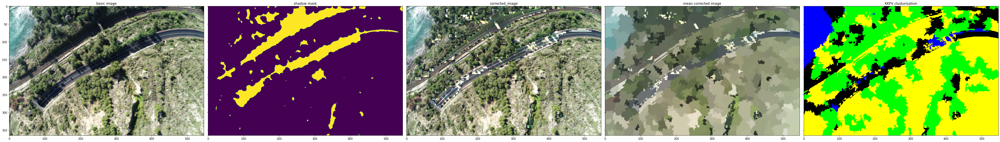

In [39]:
# plot img
fig, ax = plt.subplots(1, 5, figsize=(50, 50), sharex=True, sharey=True)

# Basic image
ax[0].imshow(basic_image)
ax[0].set_title('basic image')
ax[1].imshow(basic_mask)
ax[1].set_title('shadow mask')
ax[2].imshow(basic_corrected_image)
ax[2].set_title('corrected_image')
ax[3].imshow(basic_mean_img)
ax[3].set_title('mean corrected image')
ax[4].imshow(basic_img_temp_rgb)
ax[4].set_title('KKPV clusturisation')

plt.tight_layout()
plt.show()

Display of clustering

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


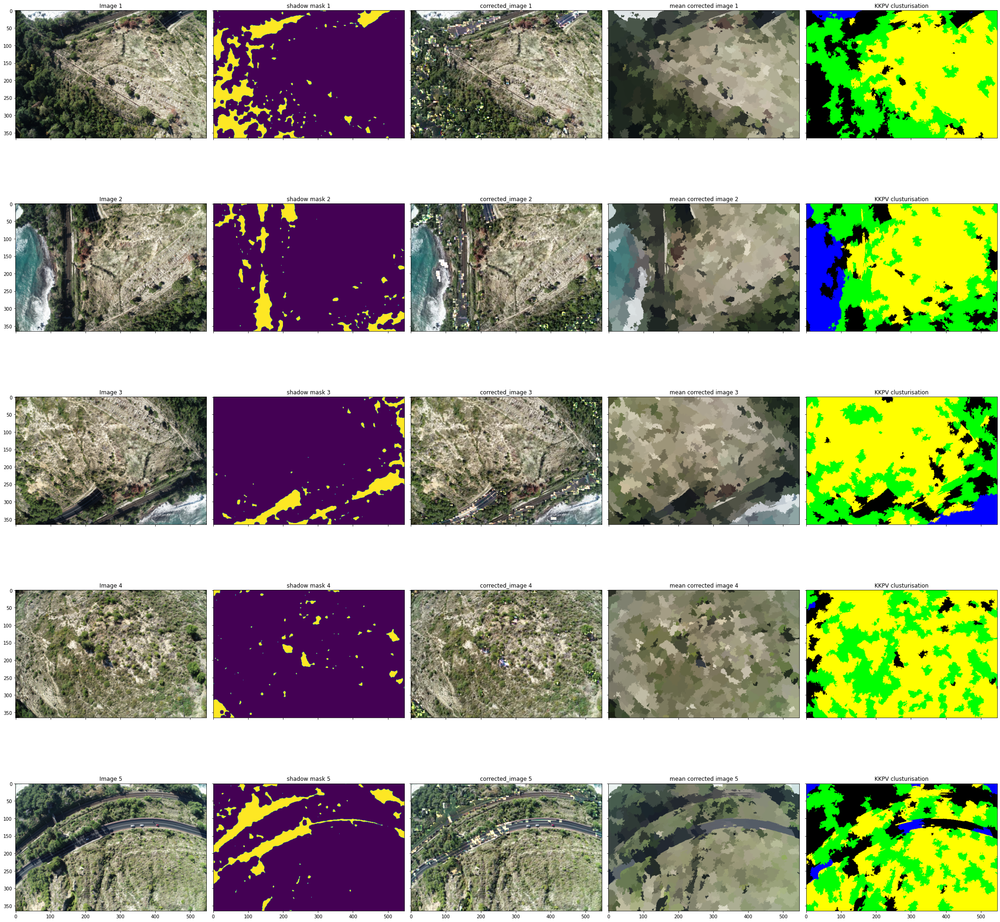

In [40]:
fig, ax = plt.subplots(5, 5, figsize=(30, 30), sharex=True, sharey=True)


# Image 1
ax[0, 0].imshow(image_1)
ax[0, 0].set_title('Image 1')
ax[0, 1].imshow(mask_1)
ax[0, 1].set_title('shadow mask 1')
ax[0, 2].imshow(corrected_image_1)
ax[0, 2].set_title('corrected_image 1')
ax[0, 3].imshow(mean_img_1)
ax[0, 3].set_title('mean corrected image 1')
ax[0, 4].imshow(img_temp_rgb_1)
ax[0, 4].set_title('KKPV clusturisation')

# Image 2
ax[1, 0].imshow(image_2)
ax[1, 0].set_title('Image 2')
ax[1, 1].imshow(mask_2)
ax[1, 1].set_title('shadow mask 2')
ax[1, 2].imshow(corrected_image_2)
ax[1, 2].set_title('corrected_image 2')
ax[1, 3].imshow(mean_img_2)
ax[1, 3].set_title('mean corrected image 2')
ax[1, 4].imshow(img_temp_rgb_2)
ax[1, 4].set_title('KKPV clusturisation')

# Image 3
ax[2, 0].imshow(image_3)
ax[2, 0].set_title('Image 3')
ax[2, 1].imshow(mask_3)
ax[2, 1].set_title('shadow mask 3')
ax[2, 2].imshow(corrected_image_3)
ax[2, 2].set_title('corrected_image 3')
ax[2, 3].imshow(mean_img_3)
ax[2, 3].set_title('mean corrected image 3')
ax[2, 4].imshow(img_temp_rgb_3)
ax[2, 4].set_title('KKPV clusturisation')

# Image 4 
ax[3, 0].imshow(image_4)
ax[3, 0].set_title('Image 4')
ax[3, 1].imshow(mask_4)
ax[3, 1].set_title('shadow mask 4')
ax[3, 2].imshow(corrected_image_4)
ax[3, 2].set_title('corrected_image 4')
ax[3, 3].imshow(mean_img_4)
ax[3, 3].set_title('mean corrected image 4')
ax[3, 4].imshow(img_temp_rgb_4)
ax[3, 4].set_title('KKPV clusturisation')

# Image 5
ax[4, 0].imshow(image_5)
ax[4, 0].set_title('Image 5')
ax[4, 1].imshow(mask_5)
ax[4, 1].set_title('shadow mask 5')
ax[4, 2].imshow(corrected_image_5)
ax[4, 2].set_title('corrected_image 5')
ax[4, 3].imshow(mean_img_5)
ax[4, 3].set_title('mean corrected image 5')
ax[4, 4].imshow(img_temp_rgb_5)
ax[4, 4].set_title('KKPV clusturisation')

plt.tight_layout()
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


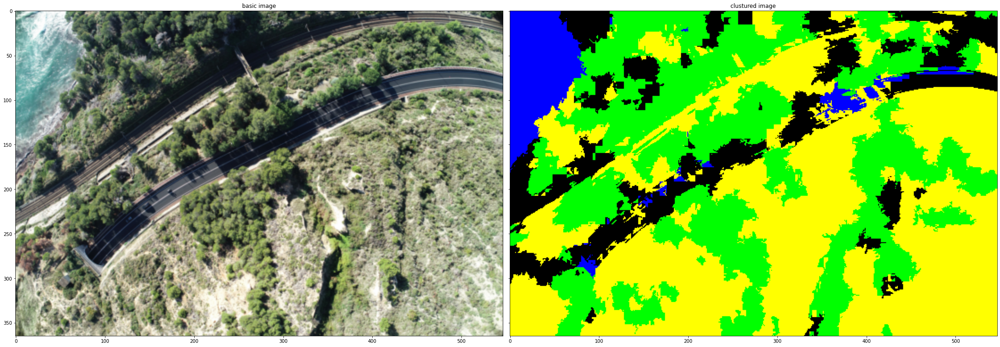

In [41]:
fig, ax = plt.subplots(1, 2, figsize=(30, 30), sharex=True, sharey=True)

ax[0].imshow(basic_image)
ax[0].set_title('basic image')

ax[1].imshow(basic_img_temp_rgb)
ax[1].set_title('clustured image')

plt.tight_layout()
plt.show()